# Color and Gradient Thresholding

Purpose : Seperate lane lines(yellow and white) from other objects in the video

* Color Thresholding: detect yellow and white pixels from 
* Gradient Thresholding: only seperate lane lines from other objects


In [1]:
import numpy as np
import pickle
import cv2
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import glob
import os

# Import everything needed to edit/save/watch video clips
from moviepy.editor import VideoFileClip
from IPython.display import HTML

## Create samples from given test video clip

In [2]:
test_videos_name = ['project_video.mp4','challenge_video.mp4','harder_challenge_video.mp4']

In [10]:
clip_test = VideoFileClip('challenge_video.mp4')

In [16]:
idx_test_image = 0

for test_video_name in test_videos_name:
    clip_test = VideoFileClip(test_video_name)
    times = np.round(np.linspace(0, clip_test.end - 0.1, 10),2)
    for time in times:
        print(time)
        img_path = 'test_images/test_img_{0}.jpg'.format(idx_test_image)
        frame = clip_test.save_frame(img_path, time)
        idx_test_image += 1

0.0
5.59
11.18
16.77
22.36
27.94
33.53
39.12
44.71
50.3
0.0
1.78
3.57
5.35
7.13
8.92
10.7
12.48
14.27
16.05
0.0
5.32
10.64
15.95
21.27
26.59
31.91
37.22
42.54
47.86


In [3]:
test_images = glob.glob('test_images/test_img*.jpg')

In [45]:
row_list = []
row_merged = ''
for idx, img in enumerate(dict_test_image.values()):
    col = idx % ncols
    row = int(idx / ncols)
    try:
        row_merged = np.hstack((row_merged, img))
    except:
        row_merged = img
    if col == ncols - 1:
        print('row_sep')
        row_list.append(row_merged)
        row_merged = ''

row_sep
row_sep
row_sep


In [49]:
for row in row_list:
    try:
        img_merged = np.vstack((img_merged, row))
    except:
        print('no img_merged found')
        img_merged = row

no img_merged found


In [52]:
12800/3440

3.7209302325581395

In [50]:
img_merged.shape

(2160, 12800, 3)

In [55]:
img_to_show = cv2.resize(img_merged, dsize=(int(img_merged.shape[1]/4), int(img_merged.shape[0]/1.5)), interpolation=cv2.INTER_AREA)

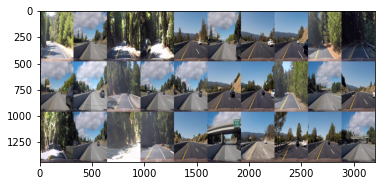

In [56]:
plt.imshow(img_to_show)

In [58]:
cv2.imwrite('test_images/test_sample.png',cv2.cvtColor(img_to_show, cv2.COLOR_RGB2BGR))

True

In [12]:
len(row_list)

0

In [4]:
dict_test_image = dict()
for img_path in test_images:
    dict_test_image[img_path] = mpimg.imread(img_path)

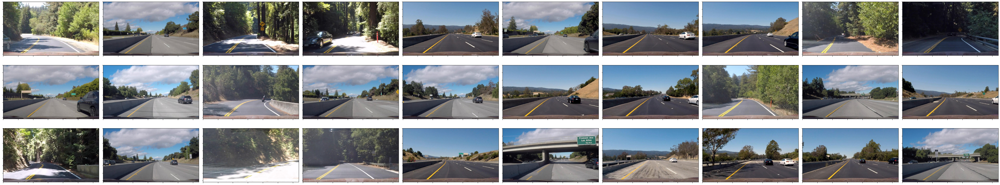

In [5]:
ncols = 10
nrows = 3
fig, axes = plt.subplots(nrows=nrows, ncols=ncols, figsize=(50,10))

for idx, img in enumerate(dict_test_image.values()):
    col = idx % ncols
    row = int(idx / ncols)
    axe = axes[row][col]
    axe.imshow(img)
    axe.set_yticklabels([])
    axe.set_xticklabels([])

fig.tight_layout()
plt.savefig("color_pick.png")
plt.show()

## Apply Color Filter to the images

In [9]:
def color_pick(image):
    hsv_image = cv2.cvtColor(image, cv2.COLOR_RGB2HSV)
    lower_white = np.array([0, 0, 100])
    upper_white = np.array([255, 30, 255])
    white_mask = cv2.inRange(hsv_image, lower_white, upper_white)
    
    lower_yellow = np.array([10, 0, 0])
    upper_yellow = np.array([70, 255, 255])
    yellow_mask = cv2.inRange(hsv_image, lower_yellow, upper_yellow)
    
    mask = cv2.bitwise_or(white_mask, yellow_mask)    
    return cv2.bitwise_and(image, image, mask = mask)

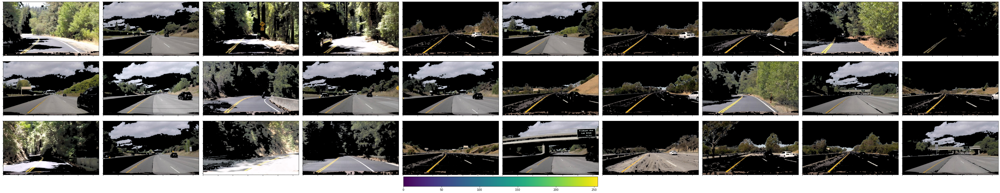

In [10]:
fig, axes = plt.subplots(nrows=nrows, ncols=ncols, figsize=(50,10))
images=[]
for idx, img in enumerate(dict_test_image.values()):
    col = idx % ncols
    row = int(idx / ncols)
    axe = axes[row][col]
    images.append(axe.imshow(color_pick(img), vmin=0, vmax=255))
    axe.set_yticklabels([])
    axe.set_xticklabels([])

fig.tight_layout()
fig.colorbar(images[-1], ax=axes, orientation='horizontal', fraction=0.05, pad=0.01)
plt.show()

## Evaluate each channel that can describe lane line

### RGB Channel

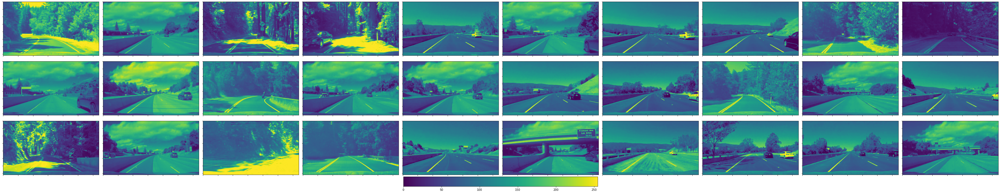

In [53]:
fig, axes = plt.subplots(nrows=nrows, ncols=ncols, figsize=(50,10))
images=[]
for idx, img in enumerate(dict_test_image.values()):
    col = idx % ncols
    row = int(idx / ncols)
    axe = axes[row][col]
    images.append(axe.imshow(img[:,:,0], vmin=0, vmax=255))
    axe.set_yticklabels([])
    axe.set_xticklabels([])

fig.tight_layout()
fig.colorbar(images[-1], ax=axes, orientation='horizontal', fraction=0.05, pad=0.01)
plt.show()

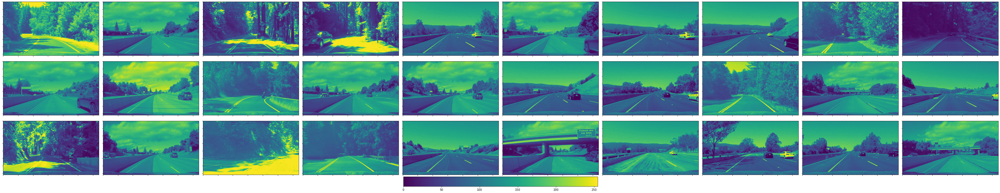

In [54]:
fig, axes = plt.subplots(nrows=nrows, ncols=ncols, figsize=(50,10))
images=[]
for idx, img in enumerate(dict_test_image.values()):
    col = idx % ncols
    row = int(idx / ncols)
    axe = axes[row][col]
    images.append(axe.imshow(img[:,:,1], vmin=0, vmax=255))
    axe.set_yticklabels([])
    axe.set_xticklabels([])

fig.tight_layout()
fig.colorbar(images[-1], ax=axes, orientation='horizontal', fraction=0.05, pad=0.01)
plt.show()

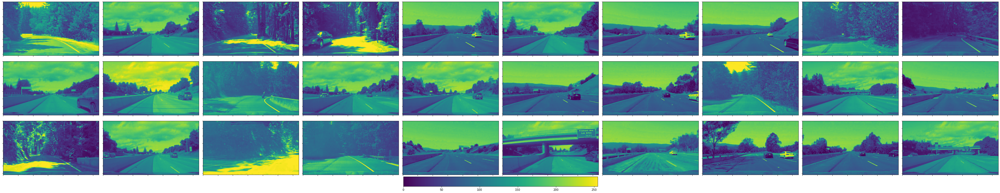

In [55]:
fig, axes = plt.subplots(nrows=nrows, ncols=ncols, figsize=(50,10))
images=[]
for idx, img in enumerate(dict_test_image.values()):
    col = idx % ncols
    row = int(idx / ncols)
    axe = axes[row][col]
    images.append(axe.imshow(img[:,:,2], vmin=0, vmax=255))
    axe.set_yticklabels([])
    axe.set_xticklabels([])

fig.tight_layout()
fig.colorbar(images[-1], ax=axes, orientation='horizontal', fraction=0.05, pad=0.01)
plt.show()

### HLS Channel

In [60]:
dict_test_image_hls = dict()

for path, img in dict_test_image.items():
    dict_test_image_hls[path] = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)

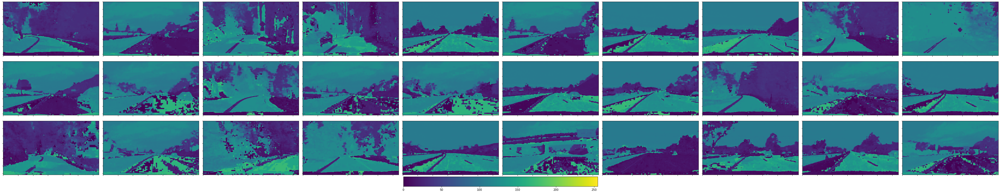

In [61]:
fig, axes = plt.subplots(nrows=nrows, ncols=ncols, figsize=(50,10))
images=[]
for idx, img in enumerate(dict_test_image_hls.values()):
    col = idx % ncols
    row = int(idx / ncols)
    axe = axes[row][col]
    images.append(axe.imshow(img[:,:,0], vmin=0, vmax=255))
    axe.set_yticklabels([])
    axe.set_xticklabels([])

fig.tight_layout()
fig.colorbar(images[-1], ax=axes, orientation='horizontal', fraction=0.05, pad=0.01)
plt.show()

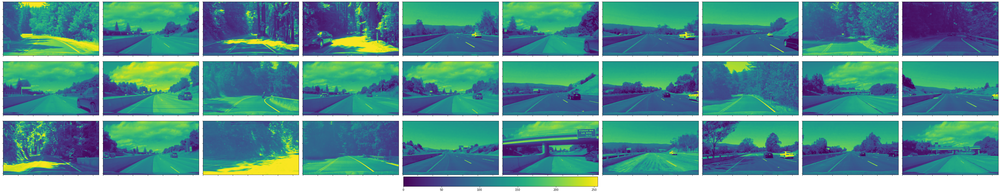

In [63]:
fig, axes = plt.subplots(nrows=nrows, ncols=ncols, figsize=(50,10))
images=[]
for idx, img in enumerate(dict_test_image_hls.values()):
    col = idx % ncols
    row = int(idx / ncols)
    axe = axes[row][col]
    images.append(axe.imshow(img[:,:,1], vmin=0, vmax=255))
    axe.set_yticklabels([])
    axe.set_xticklabels([])

fig.tight_layout()
fig.colorbar(images[-1], ax=axes, orientation='horizontal', fraction=0.05, pad=0.01)
plt.show()

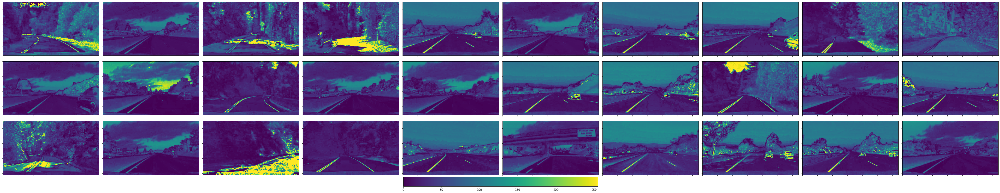

In [64]:
fig, axes = plt.subplots(nrows=nrows, ncols=ncols, figsize=(50,10))
images=[]
for idx, img in enumerate(dict_test_image_hls.values()):
    col = idx % ncols
    row = int(idx / ncols)
    axe = axes[row][col]
    images.append(axe.imshow(img[:,:,2], vmin=0, vmax=255))
    axe.set_yticklabels([])
    axe.set_xticklabels([])

fig.tight_layout()
fig.colorbar(images[-1], ax=axes, orientation='horizontal', fraction=0.05, pad=0.01)
plt.show()

Remarks:
* RGB Channel --> use R Channel
  * R Channel: the both lane color (white, yellow) is visualized very clear
  * G,B Channel: one side of the lane lines is not visible or weaker than the R channel
* HLS Channel --> use H and S Channel
  * H Channel: the lane lines are represented as lower values
  * L Channel: not use this one since doesn't make any difference to the R Channel
  * S Channel: the lane lines are represented as higher values

In [ ]:
Use R Channel to find the image

In [ ]:
def canny(img, low_threshold, high_threshold):
    """Applies the Canny transform"""
    return cv2.Canny(img, low_threshold, high_threshold)

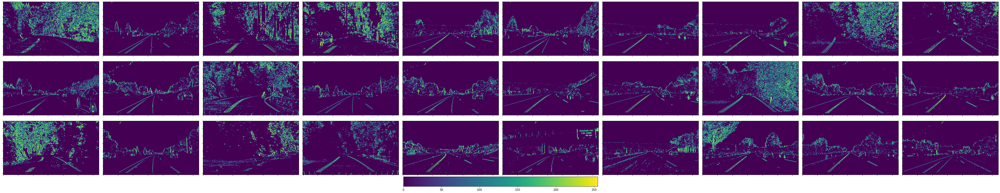

In [155]:
fig, axes = plt.subplots(nrows=nrows, ncols=ncols, figsize=(50,10))

images=[]

r_thresh = [100,255]
sx_thresh=[20, 150]
r_canny_thresh = [50, 150]

for idx, img in enumerate(dict_test_image.values()):
    col = idx % ncols
    row = int(idx / ncols)
    axe = axes[row][col]
    img = cv2.medianBlur(img, 3)
    r_channel = img[:,:,0]
#     r_channel = cv2.cvtColor(img,cv2.COLOR_RGB2GRAY)
    
    # Threshold x gradient
    sobelx = cv2.Sobel(r_channel, cv2.CV_64F, 1, 0) # Take the derivative in x
    abs_sobelx = np.absolute(sobelx) # Absolute x derivative to accentuate lines away from horizontal
    scaled_sobel = np.uint8(255*abs_sobelx/np.max(abs_sobelx))
    
    sxbinary = np.zeros_like(scaled_sobel)
    sxbinary[(scaled_sobel >= sx_thresh[0]) & (scaled_sobel <= sx_thresh[1])] = 255
    
    images.append(axe.imshow(sxbinary, vmin=0, vmax=255))
    axe.set_yticklabels([])
    axe.set_xticklabels([])

fig.tight_layout()
fig.colorbar(images[-1], ax=axes, orientation='horizontal', fraction=0.05, pad=0.01)
plt.show()

White Filter

In [ ]:
fig, axes = plt.subplots(nrows=nrows, ncols=ncols, figsize=(50,10))

images=[]

r_thresh = [100,255]
sx_thresh=[20, 150]
r_canny_thresh = [50, 150]

for idx, img in enumerate(dict_test_image.values()):
    col = idx % ncols
    row = int(idx / ncols)
    axe = axes[row][col]
    img = cv2.medianBlur(img, 3)
    r_channel = img[:,:,0]
#     r_channel = cv2.cvtColor(img,cv2.COLOR_RGB2GRAY)
    
    # Threshold x gradient
    sobelx = cv2.Sobel(r_channel, cv2.CV_64F, 1, 0) # Take the derivative in x
    abs_sobelx = np.absolute(sobelx) # Absolute x derivative to accentuate lines away from horizontal
    scaled_sobel = np.uint8(255*abs_sobelx/np.max(abs_sobelx))
    
    sxbinary = np.zeros_like(scaled_sobel)
    sxbinary[(scaled_sobel >= sx_thresh[0]) & (scaled_sobel <= sx_thresh[1])] = 255
    
    images.append(axe.imshow(sxbinary, vmin=0, vmax=255))
    axe.set_yticklabels([])
    axe.set_xticklabels([])

fig.tight_layout()
fig.colorbar(images[-1], ax=axes, orientation='horizontal', fraction=0.05, pad=0.01)
plt.show()

In [152]:
the s channel

SyntaxError: invalid syntax (<ipython-input-152-b525a67dee9a>, line 1)

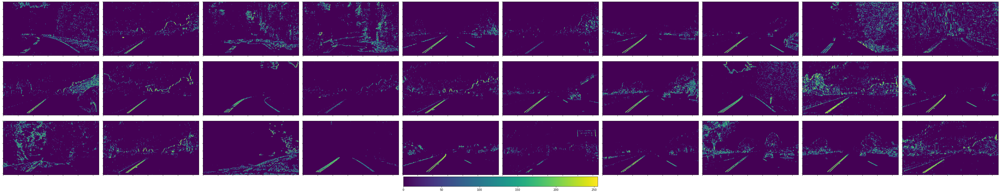

In [147]:
fig, axes = plt.subplots(nrows=nrows, ncols=ncols, figsize=(50,10))

images=[]

thresh = [100,255]
sx_thresh=[20, 100]
r_canny_thresh = [50, 150]

for idx, img in enumerate(dict_test_image_hls.values()):
    col = idx % ncols
    row = int(idx / ncols)
    axe = axes[row][col]
    img = cv2.medianBlur(img, 5)
    channel = img[:,:,2]
    
    # Threshold x gradient
    sobelx = cv2.Sobel(channel, cv2.CV_64F, 1, 0) # Take the derivative in x
    abs_sobelx = np.absolute(sobelx) # Absolute x derivative to accentuate lines away from horizontal
    scaled_sobel = np.uint8(255*abs_sobelx/np.max(abs_sobelx))
    
    sxbinary = np.zeros_like(scaled_sobel)
    sxbinary[(scaled_sobel >= sx_thresh[0]) & (scaled_sobel <= sx_thresh[1])] = 255
    
    images.append(axe.imshow(sxbinary, vmin=0, vmax=255))
    axe.set_yticklabels([])
    axe.set_xticklabels([])

fig.tight_layout()
fig.colorbar(images[-1], ax=axes, orientation='horizontal', fraction=0.05, pad=0.01)
plt.show()

In [170]:
def thresholding(img):
    img = sobel_threshold(img)
    return img

def threshold_color(image, r_thresh=[100,255], s_thresh=(170, 255), sx_thresh=[20, 150]):
    # Threshold x gradient
    image = cv2.medianBlur(image, 3) # use median filter to color visualy
    hls = cv2.cvtColor(image, cv2.COLOR_RGB2HLS)
    r_channel = image[:,:,0]
    sobelx = cv2.Sobel(r_channel, cv2.CV_64F, 1, 0) # Take the derivative in x
    abs_sobelx = np.absolute(sobelx) # Absolute x derivative to accentuate lines away from horizontal
    scaled_sobel = np.uint8(255*abs_sobelx/np.max(abs_sobelx))
    sxbinary = np.zeros_like(scaled_sobel)
    sxbinary[(scaled_sobel >= sx_thresh[0]) & (scaled_sobel <= sx_thresh[1])] = 255
    
    s_channel = hls[:,:,2]
    s_binary = np.zeros_like(s_channel)
    s_binary[(s_channel >= s_thresh[0]) & (s_channel <= s_thresh[1])] = 255
    
    color_binary = np.dstack((sxbinary, s_binary, np.zeros_like(sxbinary)))
    return color_binary

def sobel_threshold(image, s_thresh=(170, 255), sx_thresh=(20, 100)):
    image = cv2.medianBlur(image, 3) # use median filter to color visualy
    hls = cv2.cvtColor(image, cv2.COLOR_RGB2HLS)
    l_channel = hls[:,:,1]
    s_channel = hls[:,:,2]
    # Sobel x
    sobelx = cv2.Sobel(l_channel, cv2.CV_64F, 1, 0) # Take the derivative in x
    abs_sobelx = np.absolute(sobelx) # Absolute x derivative to accentuate lines away from horizontal
    scaled_sobel = np.uint8(255*abs_sobelx/np.max(abs_sobelx))
    
    # Threshold x gradient
    sxbinary = np.zeros_like(scaled_sobel)
    sxbinary[(scaled_sobel >= sx_thresh[0]) & (scaled_sobel <= sx_thresh[1])] = 255
    
    # Threshold color channel
    s_binary = np.zeros_like(s_channel)
    s_binary[(s_channel >= s_thresh[0]) & (s_channel <= s_thresh[1])] = 255
    
    color_binary = sxbinary + s_binary
    ret, color_binary_out = cv2.threshold(color_binary, 1, 255, cv2.THRESH_BINARY)
    color_binary = np.dstack((color_binary, np.zeros_like(color_binary), np.zeros_like(color_binary)))
    return color_binary

In [171]:
for test_video_name in test_videos_name:
    clip_test = VideoFileClip(test_video_name)
    test_output = 'test_videos_output/{0}_thresholding.mp4'.format(test_video_name.split('.')[0])
    clip_output = clip_test.fl_image(thresholding)
    clip_output.write_videofile(test_output, audio=False)

t:   0%|          | 6/1260 [00:00<00:22, 55.60it/s, now=None]

Moviepy - Building video test_videos_output/project_video_thresholding.mp4.
Moviepy - Writing video test_videos_output/project_video_thresholding.mp4



Moviepy - Done !
Moviepy - video ready test_videos_output/project_video_thresholding.mp4


t:   1%|          | 6/485 [00:00<00:08, 55.88it/s, now=None]

Moviepy - Building video test_videos_output/challenge_video_thresholding.mp4.
Moviepy - Writing video test_videos_output/challenge_video_thresholding.mp4



Moviepy - Done !
Moviepy - video ready test_videos_output/challenge_video_thresholding.mp4


t:   0%|          | 5/1199 [00:00<00:26, 45.69it/s, now=None]

Moviepy - Building video test_videos_output/harder_challenge_video_thresholding.mp4.
Moviepy - Writing video test_videos_output/harder_challenge_video_thresholding.mp4



Moviepy - Done !
Moviepy - video ready test_videos_output/harder_challenge_video_thresholding.mp4


In [167]:
HTML("""
<video width="960" height="540" controls>
  <source src="{0}">
</video>
""".format(test_output))